In [ ]:
import os
import glob as glob
import matplotlib.pyplot as plt
import cv2
import requests
import random
import numpy as np

np.random.seed(42)

In [ ]:
TRAIN = True
# Number of epochs to train for.
EPOCHS = 100

In [ ]:
if not os.path.exists('train'):
  !curl -L "https://universe.roboflow.com/ds/iVOkZskNvf?key=qK0xCrGOkP" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip
  dirs = {'train', 'valid', 'test'}

  for i, dir_name in enumerate(dirs):
    all_image_names = sorted(os.listdir(f"{dir_name}/images/"))
    for j, image_name in enumerate(all_image_names):
      if (j%2)==0:
        file_name = image_name.split('.jpg')[0]
        os.remove(f"{dir_name}/images/{image_name}")
        os.remove(f"{dir_name}/labels/{file_name}.txt")


Streaming output truncated to the last 5000 lines.
 extracting: test/images/A06-076_jpg.rf.48d14b0495ec2738c0a059f81d21327c.jpg  
 extracting: test/images/A06-092_jpg.rf.801e3c466e1ab305472c2f8541d2989e.jpg  
 extracting: test/images/A06-097_jpg.rf.e5a5b9b5e15877e388758595d7f4e8d5.jpg  
 extracting: test/images/A06-104_jpg.rf.6f1cf16ffc62ff3cd519fedcf7fd7249.jpg  
 extracting: test/images/A06-132_jpg.rf.169d3e4acc7c1875d85971346990d32e.jpg  
 extracting: test/images/A06-151_jpg.rf.0a797e78a79e3923ac30c1bf73e611f6.jpg  
 extracting: test/images/A06-152_jpg.rf.2506f5f99d5eaf87d1accb877bdc98c7.jpg  
 extracting: test/images/A06-160_jpg.rf.eaed2637a2dd9e49d42681677d1728e0.jpg  
 extracting: test/images/A06-169_jpg.rf.e4c52472b26d6efab52f18c608d64a36.jpg  
 extracting: test/images/A06-170_jpg.rf.90748c66224154f7bb2b63c6476f8a4b.jpg  
 extracting: test/images/A06-178_jpg.rf.790e34c12e37dfd874523fa6390ea8f8.jpg  
 extracting: test/images/A06-183_jpg.rf.538b3c7808273d20ff958abdac3594da.jpg  
 

In [ ]:
class_names = ['axe', 'bomb', 'bow', 'cleaver', 'cutlass', 'katana', 'knife', 'mace', 'machine gun', 'morningstar', 'pistol', 'rifle', 'rocket launcher', 'scabbard', 'scope', 'shield', 'shotgun', 'sickle', 'smg', 'sniper rifle', 'spear', 'sword', 'war hammer']
colors = np.random.uniform(0, 255, size = (len(class_names), 3))

In [ ]:
#function to convert bounding boxes in yolo format to xmin, ymin, ymax, xmax
def yolo2bbox(bboxes):
  xmin, ymin = bboxes[0]-bboxes[2]/2, bboxes[1]-bboxes[3]/2
  xmax, ymax = bboxes[0]+bboxes[2]/2, bboxes[1]+bboxes[3]/2
  return xmin, ymin, xmax, ymax

In [ ]:
def plot_box(image, bboxes, labels):
    # Need the image height and width to denormalize
    # the bounding box coordinates
    h, w, _ = image.shape
    for box_num, box in enumerate(bboxes):
        x1, y1, x2, y2 = yolo2bbox(box)
        # denormalize the coordinates
        xmin = int(x1*w)
        ymin = int(y1*h)
        xmax = int(x2*w)
        ymax = int(y2*h)
        width = xmax - xmin
        height = ymax - ymin

        class_name = class_names[int(labels[box_num])]

        cv2.rectangle(
            image,
            (xmin, ymin), (xmax, ymax),
            color=colors[class_names.index(class_name)],
            thickness=2
        )

        font_scale = min(1,max(3,int(w/500)))
        font_thickness = min(2, max(10,int(w/50)))

        p1, p2 = (int(xmin), int(ymin)), (int(xmax), int(ymax))
        # Text width and height
        tw, th = cv2.getTextSize(
            class_name,
            0, fontScale=font_scale, thickness=font_thickness
        )[0]
        p2 = p1[0] + tw, p1[1] + -th - 10
        cv2.rectangle(
            image,
            p1, p2,
            color=colors[class_names.index(class_name)],
            thickness=-1,
        )
        cv2.putText(
            image,
            class_name,
            (xmin+1, ymin-10),
            cv2.FONT_HERSHEY_SIMPLEX,
            font_scale,
            (255, 255, 255),
            font_thickness
        )
    return image

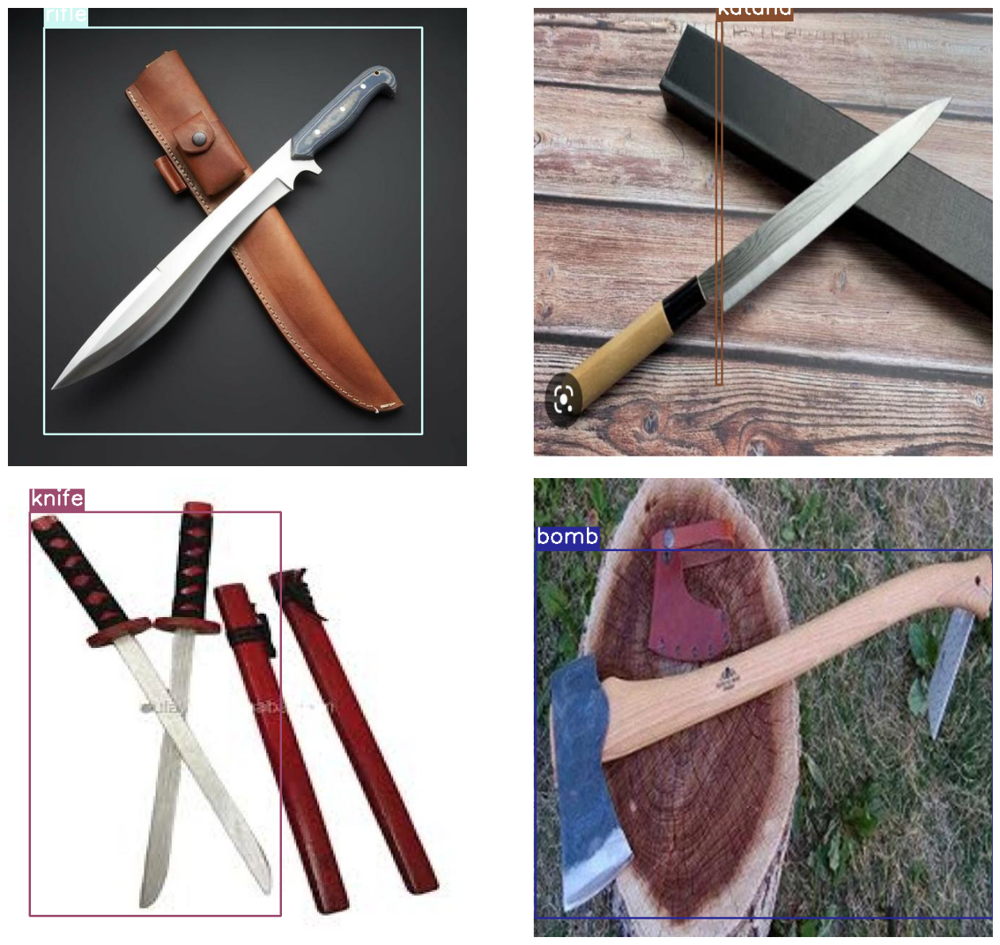

In [ ]:
def plot(image_paths, label_paths, num_samples):
    all_training_images = glob.glob(image_paths)
    all_training_labels = glob.glob(label_paths)
    all_training_images.sort()
    all_training_labels.sort()

    num_images = len(all_training_images)

    plt.figure(figsize=(15, 12))
    for i in range(num_samples):
        j = random.randint(0, num_images - 1)
        image = cv2.imread(all_training_images[j])
        with open(all_training_labels[j], 'r') as f:
            bboxes = []
            labels = []
            label_lines = f.readlines()
            for label_line in label_lines:
                label_parts = label_line.split()
                if len(label_parts) >= 5:  # Ensure at least 5 elements in the split result
                    label = label_parts[0]
                    x_c, y_c, w, h = map(float, label_parts[1:5])
                    bboxes.append([x_c, y_c, w, h])
                    labels.append(label)

            result_image = plot_box(image, bboxes, labels)
            plt.subplot(2, 2, i + 1)
            plt.imshow(result_image[:, :, ::-1])
            plt.axis('off')

    plt.subplots_adjust(wspace=0)
    plt.tight_layout()
    plt.show()

# Example usage
plot(
    image_paths='train/images/*',
    label_paths='train/labels/*',
    num_samples=4,
)


In [ ]:
def set_res_dir():
    # Directory to store results
    res_dir_count = len(glob.glob('runs/train/*'))
    print(f"Current number of result directories: {res_dir_count}")
    if TRAIN:
        RES_DIR = f"results_{res_dir_count+1}"
        print(RES_DIR)
    else:
        RES_DIR = f"results_{res_dir_count}"
    return RES_DIR

In [ ]:
# monitor progress of training. other option weights and biases
def monitor_tensorboard():
  %load_ext tensorboard
  %tensorboard --logdir runs/train

In [ ]:
if not os.path.exists('yolov5'):
    !git clone https://github.com/ultralytics/yolov5.git

Cloning into 'yolov5'...
remote: Enumerating objects: 16403, done.
remote: Counting objects: 100% (297/297), done.
remote: Compressing objects: 100% (220/220), done.
remote: Total 16403 (delta 154), reused 162 (delta 77), pack-reused 16106
Receiving objects: 100% (16403/16403), 15.15 MiB | 14.35 MiB/s, done.
Resolving deltas: 100% (11187/11187), done.


In [ ]:
%cd yolov5/
!pwd

/content/yolov5
/content/yolov5


In [ ]:
!pip install -r requirements.txt

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 196.4/196.4 kB 2.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.5/4.5 MB 12.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 709.4/709.4 kB 24.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 kB 8.7 MB/s eta 0:00:00
  Attempting uninstall: Pillow
    Found existing installation: Pillow 9.4.0
    Uninstalling Pillow-9.4.0:
      Successfully uninstalled Pillow-9.4.0
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
imageio 2.31.6 requires pillow<10.1.0,>=8.3.2, but you have pillow 10.2.0 which is incompatible.


In [ ]:
monitor_tensorboard()

<IPython.core.display.Javascript object>

# **Small**

In [ ]:
RES_DIR = set_res_dir()
if TRAIN:
    !python train.py --data ../data.yaml --weights yolov5s.pt \
    --img 640 --epochs {EPOCHS} --batch-size 16 --name {RES_DIR}

Current number of result directories: 0
results_1
2024-01-31 14:34:11.025324: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-01-31 14:34:11.025372: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-01-31 14:34:11.027145: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
train: weights=yolov5s.pt, cfg=, data=../data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=100, batch_size=16, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, evolve_population=data/hyps, resume_evolve=None, bucket=, cache=None, image_weights=Fals

In [ ]:
# Function to show validation predictions saved during training.
def show_valid_results(RES_DIR):
    !ls runs/train/{RES_DIR}
    EXP_PATH = f"runs/train/{RES_DIR}"
    validation_pred_images = glob.glob(f"{EXP_PATH}/*_pred.jpg")
    print(validation_pred_images)
    for pred_image in validation_pred_images:
        image = cv2.imread(pred_image)
        plt.figure(figsize=(19, 16))
        plt.imshow(image[:, :, ::-1])
        plt.axis('off')
        plt.show()

In [ ]:
# Helper function for inference on images.
def inference(RES_DIR, data_path):
    # Directory to store inference results.
    infer_dir_count = len(glob.glob('runs/detect/*'))
    print(f"Current number of inference detection directories: {infer_dir_count}")
    INFER_DIR = f"inference_{infer_dir_count+1}"
    print(INFER_DIR)
    # Inference on images.
    !python detect.py --weights runs/train/{RES_DIR}/weights/best.pt \
    --source {data_path} --name {INFER_DIR}
    return INFER_DIR

In [ ]:
def visualize(INFER_DIR):
# Visualize inference images.
    INFER_PATH = f"runs/detect/{INFER_DIR}"
    infer_images = glob.glob(f"{INFER_PATH}/*.jpg")
    print(infer_images)
    for pred_image in infer_images:
        image = cv2.imread(pred_image)
        plt.figure(figsize=(19, 16))
        plt.imshow(image[:, :, ::-1])
        plt.axis('off')
        plt.show()

confusion_matrix.png				   PR_curve.png		  val_batch0_pred.jpg
events.out.tfevents.1706711655.79e9ee59d5f0.589.0  R_curve.png		  val_batch1_labels.jpg
F1_curve.png					   results.csv		  val_batch1_pred.jpg
hyp.yaml					   results.png		  val_batch2_labels.jpg
labels_correlogram.jpg				   train_batch0.jpg	  val_batch2_pred.jpg
labels.jpg					   train_batch1.jpg	  weights
opt.yaml					   train_batch2.jpg
P_curve.png					   val_batch0_labels.jpg
['runs/train/results_1/val_batch1_pred.jpg', 'runs/train/results_1/val_batch0_pred.jpg', 'runs/train/results_1/val_batch2_pred.jpg']


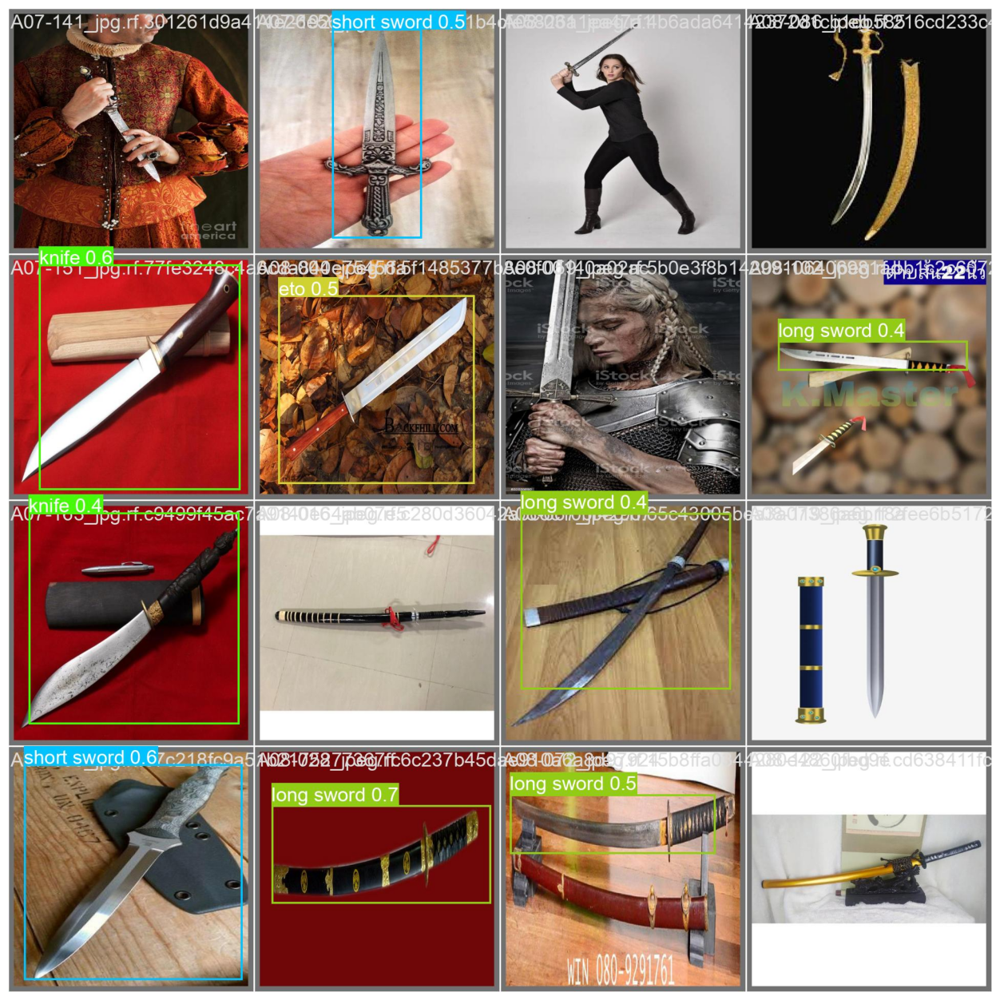

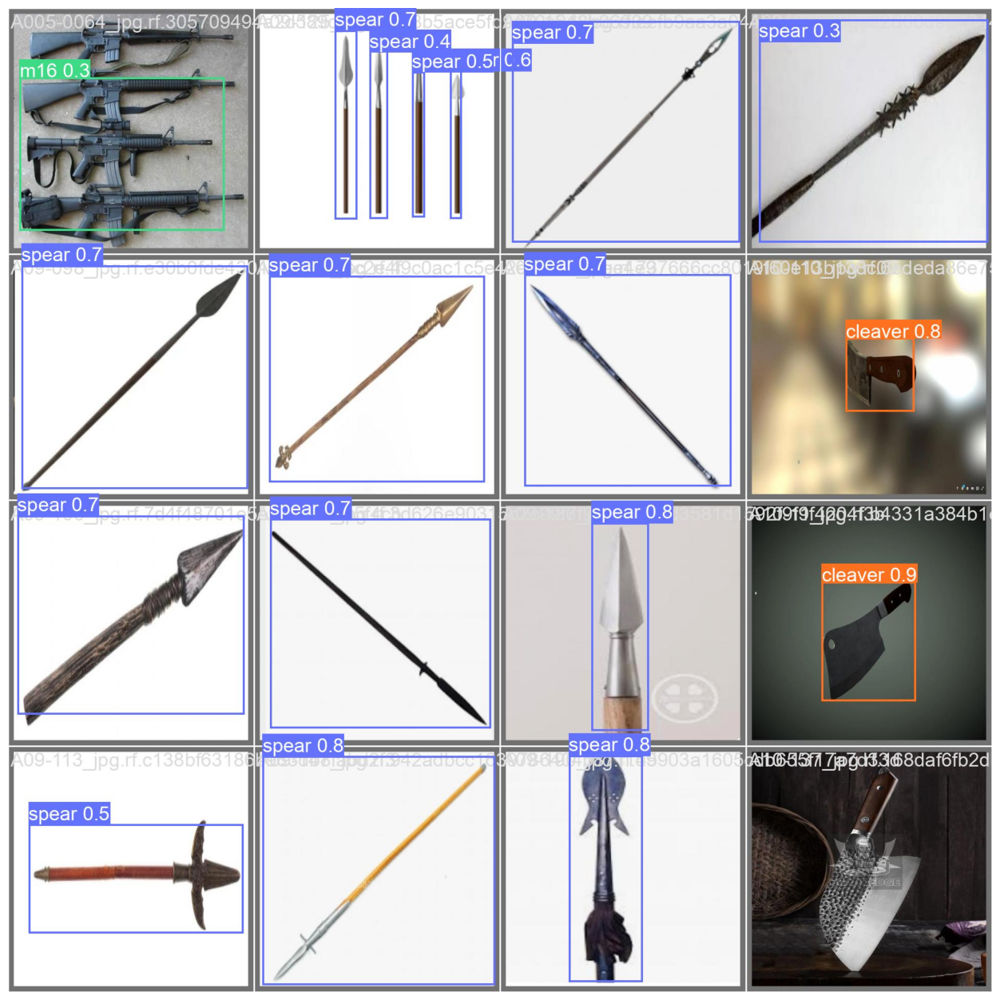

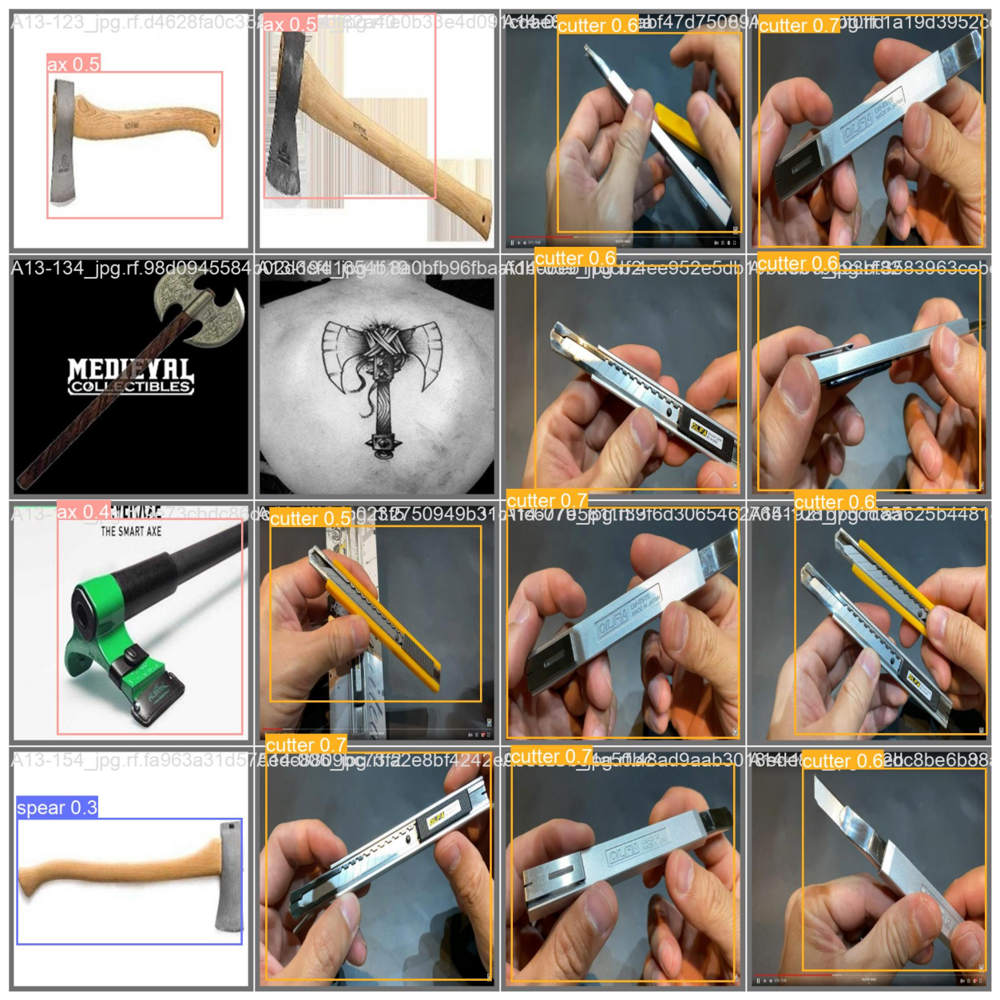

In [ ]:
show_valid_results(RES_DIR)

In [ ]:
IMAGE_INFER_DIR = inference(RES_DIR, '../test/images/')

Current number of inference detection directories: 0
inference_1
detect: weights=['runs/train/results_1/weights/best.pt'], source=../test/images/, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_csv=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=inference_1, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-282-g9cdbd1de Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
Model summary: 157 layers, 7047883 parameters, 0 gradients, 15.9 GFLOPs
image 1/142 /content/test/images/A005-0072_jpg.rf.b4f0c08c830ceca7eef7a4e94da13cc4.jpg: 640x640 (no detections), 11.7ms
image 2/142 /content/test/images/A005-0100_jpg.rf.b90935a0b749dbc936f4c55c4e2ce186.jpg: 640x640 1 ak, 1 m16, 11.7ms
image 3/142 /conte

In [ ]:
visualize(IMAGE_INFER_DIR)

# **Medium**

In [ ]:
RES_DIR = set_res_dir()
if TRAIN:
    !python train.py --data ../data.yaml --weights yolov5m.pt \
    --img 640 --epochs {EPOCHS} --batch-size 16 --name {RES_DIR}

Current number of result directories: 1
results_2
2024-01-31 15:30:54.238268: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-01-31 15:30:54.238324: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-01-31 15:30:54.240139: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
train: weights=yolov5m.pt, cfg=, data=../data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=100, batch_size=16, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, evolve_population=data/hyps, resume_evolve=None, bucket=, cache=None, image_weights=Fals

In [ ]:
# Inference on images.
IMAGE_INFER_DIR = inference(RES_DIR, '../test/images/')

Current number of inference detection directories: 1
inference_2
detect: weights=['runs/train/results_2/weights/best.pt'], source=../test/images/, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_csv=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=inference_2, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-282-g9cdbd1de Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
Model summary: 212 layers, 20905467 parameters, 0 gradients, 48.0 GFLOPs
image 1/142 /content/test/images/A005-0072_jpg.rf.b4f0c08c830ceca7eef7a4e94da13cc4.jpg: 640x640 (no detections), 27.1ms
image 2/142 /content/test/images/A005-0100_jpg.rf.b90935a0b749dbc936f4c55c4e2ce186.jpg: 640x640 1 ak, 2 m16s, 27.1ms
image 3/142 /con

In [ ]:
visualize(IMAGE_INFER_DIR)

# **Large**

In [ ]:
RES_DIR = set_res_dir()
if TRAIN:
    !python train.py --data ../data.yaml --weights yolov5l.pt \
    --img 640 --epochs {EPOCHS} --batch-size 16 --name {RES_DIR}

Current number of result directories: 2
results_3
2024-01-31 16:40:08.008014: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-01-31 16:40:08.008082: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-01-31 16:40:08.009910: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
train: weights=yolov5l.pt, cfg=, data=../data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=100, batch_size=16, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, evolve_population=data/hyps, resume_evolve=None, bucket=, cache=None, image_weights=Fals

In [ ]:
IMAGE_INFER_DIR = inference(RES_DIR, '../test/images/')

Current number of inference detection directories: 2
inference_3
detect: weights=['runs/train/results_3/weights/best.pt'], source=../test/images/, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_csv=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=inference_3, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-282-g9cdbd1de Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
Model summary: 267 layers, 46178283 parameters, 0 gradients, 107.9 GFLOPs
image 1/142 /content/test/images/A005-0072_jpg.rf.b4f0c08c830ceca7eef7a4e94da13cc4.jpg: 640x640 (no detections), 49.8ms
WARNING ⚠️ NMS time limit 0.550s exceeded
image 2/142 /content/test/images/A005-0100_jpg.rf.b90935a0b749dbc936f4c55c4e2ce186.jpg: 64

In [ ]:
visualize(IMAGE_INFER_DIR)

In [ ]:
python detect.py --weights yolov5l.pt --img-size 640 --conf 0.25 --source /content/detect.jpg